In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.animation as animation
from IPython.display import HTML
import random
import re

import matplotlib.colors as mc
import colorsys
from random import randint
import warnings
warnings.filterwarnings('ignore')

In [2]:
df = pd.read_csv('..\Resources\Data\COVID19.csv', parse_dates=['Date'])

In [3]:
df = df[['Date', 'ISO_CountryID','ISO_CountryName','Confirmed', 'Deaths', 'Recovered']]

In [4]:
df.columns

Index(['Date', 'ISO_CountryID', 'ISO_CountryName', 'Confirmed', 'Deaths',
       'Recovered'],
      dtype='object')

In [16]:
df.tail()

,date,CountryName,value
18350,2020-06-10,Viet Nam,0.0
18351,2020-06-10,Western Sahara,1.0
18352,2020-06-10,Yemen,129.0
18353,2020-06-10,Zambia,10.0
18354,2020-06-10,Zimbabwe,4.0


In [6]:
df = df.rename(columns={'ISO_CountryID': 'CountryID', 'ISO_CountryName': 'CountryName'})

In [7]:
full_table = df.groupby(['Date', 'CountryName']).sum().reset_index()

In [8]:
full_table.head()

,Date,CountryName,CountryID,Confirmed,Deaths,Recovered
0,2020-01-22,China,4836.0,547.0,17.0,28.0
1,2020-01-22,Hong Kong,344.0,0.0,0.0,0.0
2,2020-01-22,Japan,392.0,2.0,0.0,0.0
3,2020-01-22,Korea (the Republic of),410.0,1.0,0.0,0.0
4,2020-01-22,Macao,446.0,1.0,0.0,0.0


In [20]:
last_date = max(full_table['Date'])

'2020-06-10'

In [9]:
full_table['Date'] = full_table['Date'].astype('str')
df = full_table[['Date', 'CountryName', 'Deaths']]
df.columns = ['date', 'CountryName', 'value']
fnames_list = df['date'].unique().tolist()

In [10]:
def random_color_generator(number_of_colors):
    color = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
                 for i in range(number_of_colors)]
    return color

country_list = df['CountryName'].unique().tolist()

num_of_elements = 10

In [11]:
def transform_color(color, amount = 0.5):

    try:
        c = mc.cnames[color]
    except:
        c = color
        c = colorsys.rgb_to_hls(*mc.to_rgb(c))
    return colorsys.hls_to_rgb(c[0], 1 - amount * (1 - c[1]), c[2])

random_hex_colors = []
for i in range(len(country_list)):
    random_hex_colors.append('#' + '%06X' % randint(0, 0xFFFFFF))

rgb_colors = [transform_color(i, 1) for i in random_hex_colors]
rgb_colors_opacity = [rgb_colors[x] + (0.825,) for x in range(len(rgb_colors))]
rgb_colors_dark = [transform_color(i, 1.12) for i in random_hex_colors]

In [12]:
normal_colors = dict(zip(country_list, rgb_colors_opacity))
dark_colors = dict(zip(country_list, rgb_colors_dark))

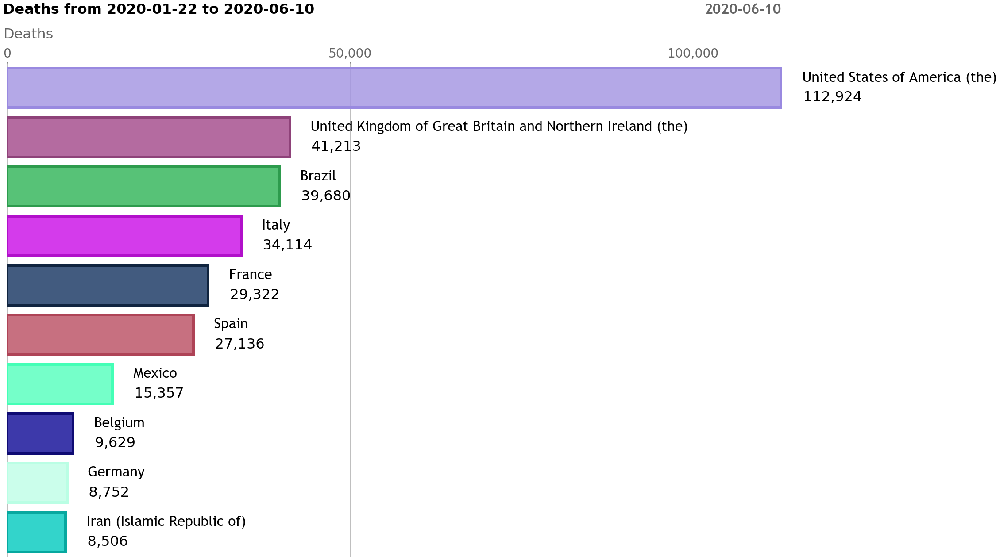

In [23]:
fig, ax = plt.subplots(figsize = (36, 20))

def draw_barchart(current_date):
    dff = df[df['date'].eq(current_date)].sort_values(by='value', ascending=True).tail(num_of_elements)
    ax.clear()
    
    ax.barh(dff['CountryName'], dff['value'], color=[normal_colors[p] for p in dff['CountryName']],
                edgecolor =([dark_colors[x] for x in dff['CountryName']]), linewidth = '6')
    dx = dff['value'].max() / 200


    for i, (value, name) in enumerate(zip(dff['value'], dff['CountryName'])):
        ax.text(value + dx, 
                i + (num_of_elements / 50), '    ' + name,
                size = 32,
                ha = 'left',
                va = 'center',
                fontdict = {'fontname': 'Trebuchet MS'})

        ax.text(value + dx,
                i - (num_of_elements / 50), 
                f'    {value:,.0f}', 
                size = 32, 
                ha = 'left', 
                va = 'center')

    time_unit_displayed = re.sub(r'\^(.*)', r'', str(current_date))
    ax.text(1.0, 
            1.1, 
            time_unit_displayed,
            transform = ax.transAxes, 
            color = '#666666',
            size = 32,
            ha = 'right', 
            weight = 'bold', 
            fontdict = {'fontname': 'Trebuchet MS'})

    ax.text(-0.005, 
            1.05, 
            'Deaths', 
            transform = ax.transAxes, 
            size = 32, 
            color = '#666666')

    ax.text(-0.005, 
            1.1, 
            'Deaths from 2020-01-22 to '+ last_date, 
            transform = ax.transAxes,
            size = 32, 
            weight = 'bold', 
            ha = 'left')

    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis = 'x', colors = '#666666', labelsize = 28)
    ax.set_yticks([])
    ax.set_axisbelow(True)
    ax.margins(0, 0.01)
    ax.grid(which = 'major', axis = 'x', linestyle = '-')

    plt.locator_params(axis = 'x', nbins = 4)
    plt.box(False)
    plt.subplots_adjust(left = 0.075, right = 0.75, top = 0.825, bottom = 0.05, wspace = 0.2, hspace = 0.2)
    plt.box(False) 


draw_barchart(last_date)

Animation size has reached 21119347 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


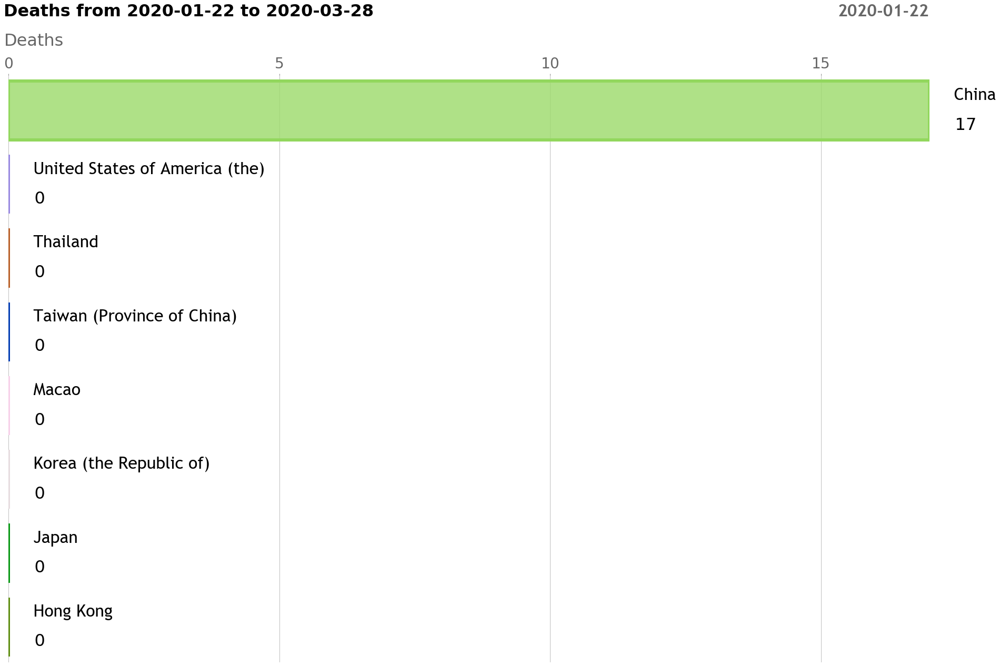

In [14]:
fig, ax = plt.subplots(figsize = (36, 20))
animator = animation.FuncAnimation(fig, draw_barchart, frames=fnames_list)
ani = HTML(animator.to_jshtml())

In [15]:
ani